In [1]:
import os

if "src" not in os.listdir():
    os.chdir("../../../")

from datetime import timedelta
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
import plotly.graph_objects as go

import keras.backend as K
from keras import Model
from keras.layers import Input, LSTM, Dense, Dropout
from keras.optimizers import Adam

%load_ext autoreload
%autoreload 2

from src.lib.stock_dataset import read_stock_dataset
from src.lib.activations import negative_softmax
from src.lib.losses import negative_profit_loss, multi_negative_sharpe_ratio_loss

In [2]:
symbols = ["SPY", "SPXS"]
n_time_steps = 64
batch_size = 128
epochs = 5

In [3]:
dataset = read_stock_dataset(symbols, "oc_ret", n_time_steps)
train, valid, test = dataset.train_valid_test_split(timedelta(days=365), timedelta(days=365), scaled=True)
n_features = train.n_features
n_symbols = train.n_symbols
print(f"Loaded {len(train)} training, {len(valid)}, validation, and {len(test)} testing samples")
print(f"{n_features} features")
print(f"{n_symbols} targets")

Loaded 366687 training, 98309, validation, and 97921 testing samples
26 features
2 targets


In [10]:
def build_model():
    target_tensor = Input((n_symbols,))

    # Simulates the return being even more random in reality due to non-perfect trade executions
    rets_std = np.std(train.y)
    rand_target_tensor = target_tensor + K.random_normal((batch_size, 2), -0.001 * rets_std, 0.01 * rets_std)

    input_tensor = Input((n_time_steps, n_features))
    z = input_tensor
    lstm_out = LSTM(64)(z)

    z = Dropout(0.25)(lstm_out)
    z = Dense(64, activation="selu")(z)
    z = Dropout(0.1)(z)
    holdings = Dense(n_symbols, activation=negative_softmax, name="holdings")(z)

    # Simulates the inability to buy fractional shares
    holdings = holdings + K.random_normal((batch_size, 2), 0, 0.01)
    
    z = Dropout(0.25)(lstm_out)
    z = Dense(64, activation="selu")(z)
    z = Dropout(0.1)(z)
    p_invest = Dense(1, activation="sigmoid", name="p_invest")(z)

    model = Model([input_tensor, target_tensor], [holdings, p_invest])

    sharpe_loss = multi_negative_sharpe_ratio_loss(rand_target_tensor, holdings)
    model.add_loss(sharpe_loss)

    adj_holdings = holdings * p_invest
    neg_adj_profit = K.sum(negative_profit_loss(rand_target_tensor, adj_holdings), axis=-1)

    model.add_loss(neg_adj_profit)

    model.compile(Adam(lr=0.001))

    pred_model = Model(input_tensor, adj_holdings)

    return model, pred_model

In [11]:
train_batchable_index = train.get_batchable_index(trade_market_open=True)
n_iter_per_epoch = len(train_batchable_index)//batch_size

loss_history = []

model, pred_model = build_model()
valid_batchable_index = valid.get_batchable_index(trade_market_open=True)
X_batch_valid, y_batch_valid = valid.get_batch(len(valid_batchable_index), valid_batchable_index, replace=False, shuffle=False)

for epoch in range(epochs):
    pbar = tqdm(range(n_iter_per_epoch))
    for i in pbar:
        X_batch, y_batch = train.get_batch(batch_size, train_batchable_index)
        loss = model.train_on_batch([X_batch, y_batch])
        loss_history.append(loss)

        if len(loss_history) > 150:
            avg_loss = np.mean(loss_history[-150:])
        else:
            avg_loss = np.mean(loss_history)
        
        pbar.set_description("sharpe=%.3f" % -avg_loss)
    
    
    losses_valid = model.evaluate([X_batch_valid, y_batch_valid])
    avg_loss_valid = np.mean(losses_valid)


    print("Valid Sharpe:", -avg_loss_valid)

  0%|          | 0/2864 [00:00<?, ?it/s]2021-09-16 13:55:11.856916: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:116] None of the MLIR optimization passes are enabled (registered 2)
2021-09-16 13:55:11.858582: W tensorflow/core/platform/profile_utils/cpu_utils.cc:126] Failed to get CPU frequency: 0 Hz
sharpe=0.006: 100%|██████████| 2864/2864 [00:58<00:00, 49.00it/s]


   1/3071 [..............................] - ETA: 5:06 - loss: nan

2021-09-16 13:56:11.236919: I tensorflow/compiler/tf2mlcompute/kernels/mlc_subgraph_op.cc:326] Compute: Failed in processing TensorFlow graph model_1/MLCSubgraphOp_1_0 with frame_id = 0 and iter_id = 0 with error: Invalid argument: Incompatible shapes: [32,2] vs. [128,2] (error will be reported 5 times unless TF_MLC_LOGGING=1).


InvalidArgumentError:  Incompatible shapes: [32,2] vs. [128,2]
	 [[node model_1/tf.__operators__.add_2/AddV2 (defined at var/folders/z3/f6ggp7nd0p97xcdwc5b5mcd80000gn/T/ipykernel_95129/4218243846.py:25) ]]
	 [[model_1/MLCSubgraphOp_1_0]] [Op:__inference_test_function_38882]

Function call stack:
test_function


AMD


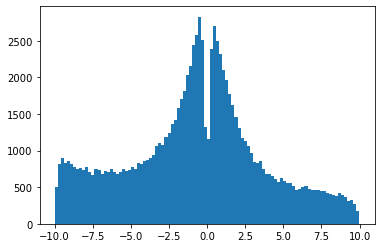

NVDA


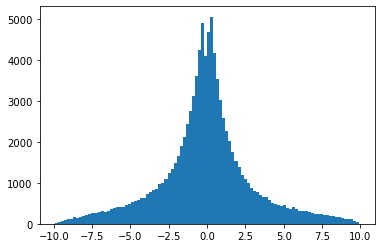

SPY


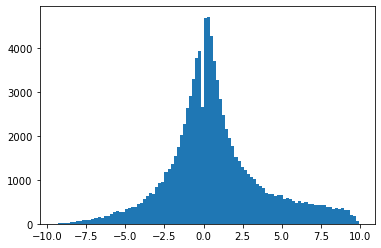

TSLA


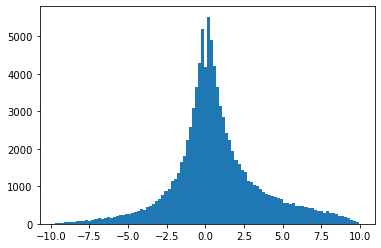

Allocation


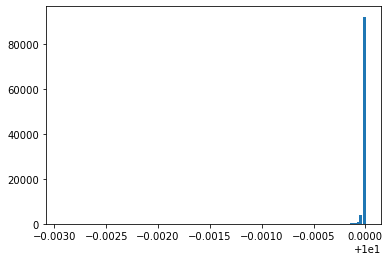

In [ ]:
preds = pred_model.predict(X_batch_valid)
for i, symbol in enumerate(symbols):
    print(symbol)
    plt.hist(preds[:, i], bins=100)
    plt.show()

print("Allocation")
plt.hist(np.abs(preds).sum(-1), bins=100)
plt.show()

In [ ]:
x = preds[:, 0]
y = preds[:, 1]

heatmap, xedges, yedges = np.histogram2d(x, y, bins=256)
# heatmap = np.log(heatmap+1)
extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]
fig = go.Figure()
fig.add_trace(go.Heatmap(z=heatmap.T))
fig.show()

In [ ]:
# rets = np.exp((np.log(preds * y_batch_valid+1)).sum(axis=-1).cumsum())
rets = ((np.log(preds * y_batch_valid+1)).sum(axis=-1).cumsum())
fig = go.Figure()
fig.add_trace(go.Scatter(x=valid.index, y=rets))
fig.show()

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=valid.index, y=preds[:, 0], name=symbols[0]))
fig.add_trace(go.Scatter(x=valid.index, y=preds[:, 1], name=symbols[1]))
fig.show()